<a href="https://colab.research.google.com/github/TomaszFilip/Colab/blob/master/tracking.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
class TrackedObject:
    def __init__(self, obj_type, x1, y1, x2, y2, obj_id=None, cat=None, cat_prob=None, overlaps=False):
        self.type = obj_type
        self.x1 = x1
        self.y1 = y1
        self.x2 = x2
        self.y2 = y2
        self.centroid = ((x1 + x2) // 2, (y1 + y2) // 2)  # Use integer division for consistency
        self.past_centroids=[]
        self.id = obj_id  # Optional ID, can be assigned later
        self.cat=cat;
        self.cat_prob=cat_prob;
        self.overlaps=overlaps;
        self.speed=None


In [ ]:
import math
from copy import deepcopy

# Function to find the minimum distance between objects in a list
def find_min_distance(objects):
    min_distance = float("inf")
    closest_pair = None

    for i in range(len(objects)):
        for j in range(i + 1, len(objects)):
            obj1, obj2 = objects[i], objects[j]
            dist = math.hypot(obj1.centroid[0] - obj2.centroid[0], obj1.centroid[1] - obj2.centroid[1])
            if dist < min_distance:
                min_distance = dist
                closest_pair = (obj1, obj2)

    return min_distance#, closest_pair
def euclidean_distance(pt1, pt2):
    return math.hypot(pt1[0] - pt2[0], pt1[1] - pt2[1])

class EuclideanDistTracker:
    def __init__(self):
        self.center_points = {}  # Stores object ID -> (centroid_x, centroid_y)
        self.id_count = 0  # Counter for assigning new IDs
        self.threshold_distance = 50  # Maximum allowed distance for tracking the same object

    def update(self, objects_rect):
        updated_objects = []
        min_distance=find_min_distance(objects_rect)

        for obj in objects_rect:
            cx, cy = obj.centroid
            assigned_id = None

            # Find the closest existing object
            for obj_id, (prev_cx, prev_cy) in self.center_points.items():
                dist = euclidean_distance((cx, cy), (prev_cx, prev_cy))

                if dist < min_distance:
                    assigned_id = obj_id
                    break  # Stop checking once we find a close enough match

            # Assign ID
            if assigned_id is not None:
                self.center_points[assigned_id] = (cx, cy)  # Update position
                obj.id = assigned_id
            else:
                # New object detected
                self.center_points[self.id_count] = (cx, cy)
                obj.id = self.id_count
                self.id_count += 1

            updated_objects.append(obj)

        # Remove old IDs that are no longer present
        self.center_points = {obj.id: obj.centroid for obj in updated_objects}

        return updated_objects

In [ ]:
def check_overlap(obj1, obj2):
    x_left = max(obj1.x1, obj2.x1)
    y_top = max(obj1.y1, obj2.y1)
    x_right = min(obj1.x2, obj2.x2)
    y_bottom = min(obj1.y2, obj2.y2)
    if x_right > x_left and y_bottom > y_top:
        return True
    else:
        return False

def get_overlap_info(objects):
    """
    Checks for overlaps between all pairs of objects in a list and returns overlap information.

    Args:
        objects (list): A list of TrackedObject instances.

    Returns:
        dict: A dictionary where keys are object IDs and values are lists of IDs of overlapping objects.
    """
    overlap_info = {}
    for i, obj1 in enumerate(objects):
        obj1.overlaps=False;
        overlap_info[obj1.id] = []  # Initialize an empty list for each object
        for j, obj2 in enumerate(objects):
            if i != j and check_overlap(obj1, obj2):
                obj1.overlaps=obj2.overlaps=True;
    return overlap_info

Using device: cuda


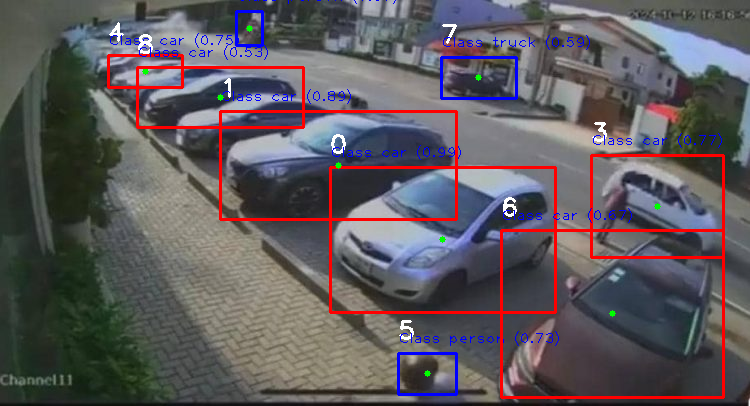

/content/drive/MyDrive/Yolo/0/0.jpg


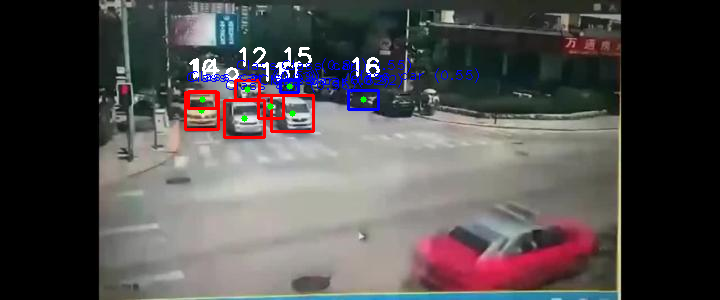

/content/drive/MyDrive/Yolo/0/1.jpg


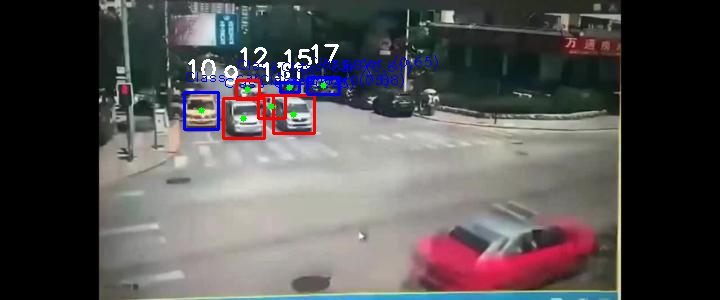

/content/drive/MyDrive/Yolo/0/2.jpg


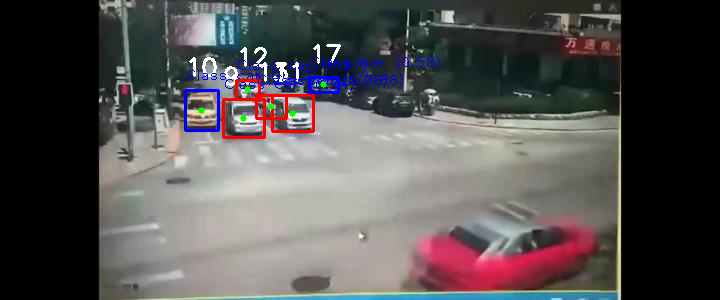

/content/drive/MyDrive/Yolo/0/3.jpg


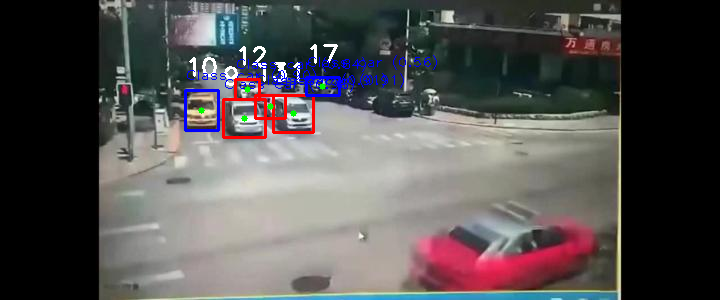

/content/drive/MyDrive/Yolo/0/4.jpg


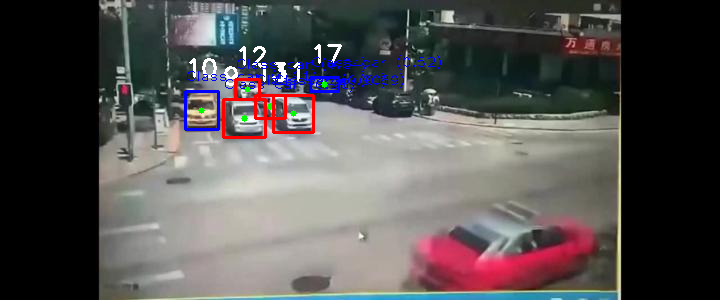

/content/drive/MyDrive/Yolo/0/5.jpg


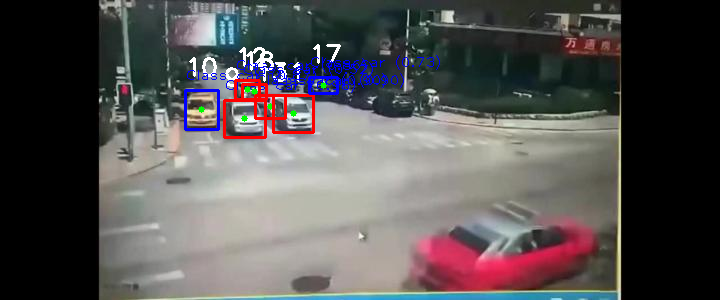

/content/drive/MyDrive/Yolo/0/6.jpg


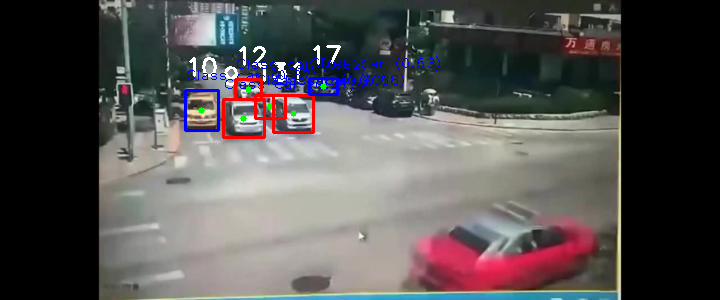

/content/drive/MyDrive/Yolo/0/7.jpg


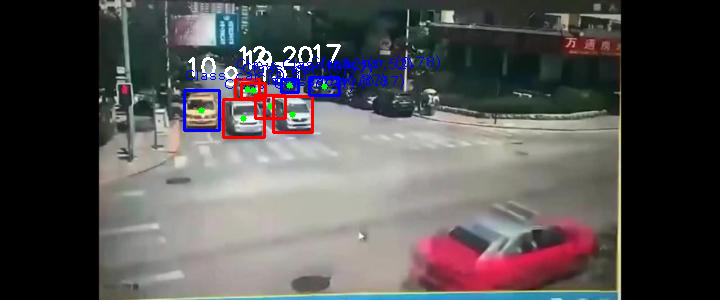

/content/drive/MyDrive/Yolo/0/8.jpg


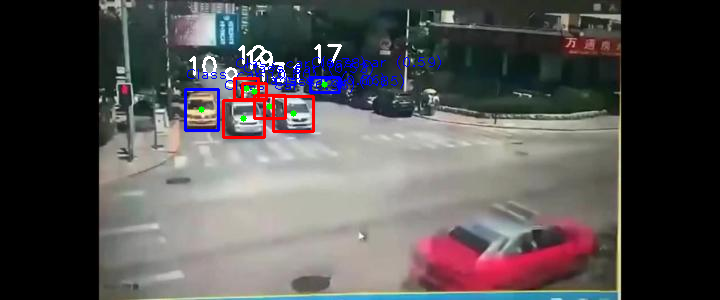

/content/drive/MyDrive/Yolo/0/9.jpg


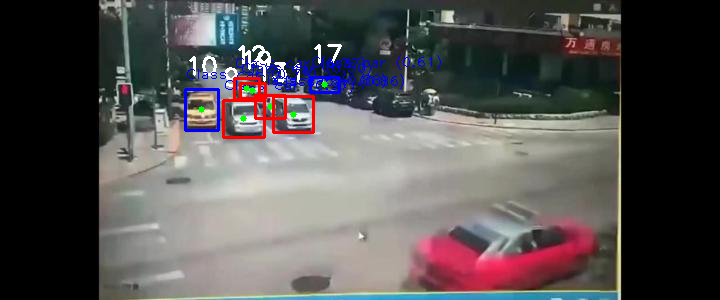

/content/drive/MyDrive/Yolo/0/10.jpg


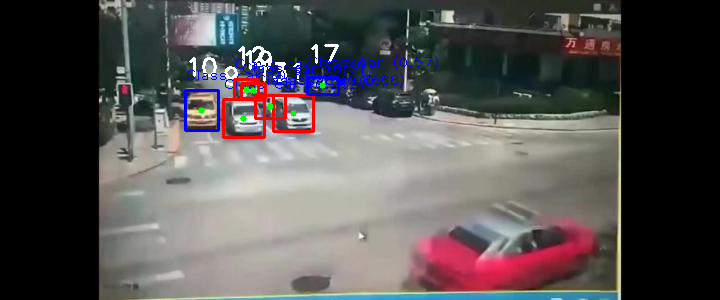

/content/drive/MyDrive/Yolo/0/11.jpg


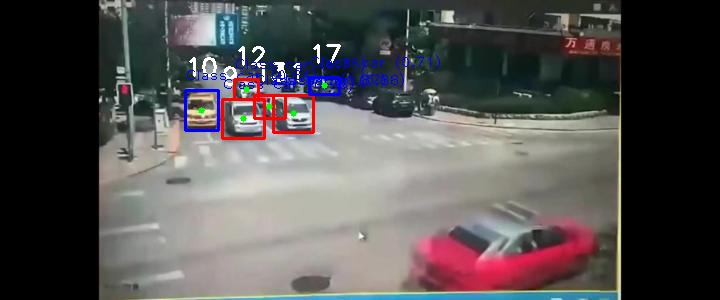

/content/drive/MyDrive/Yolo/0/12.jpg


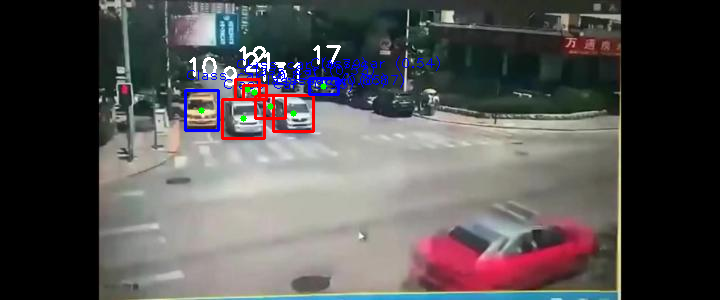

/content/drive/MyDrive/Yolo/0/13.jpg


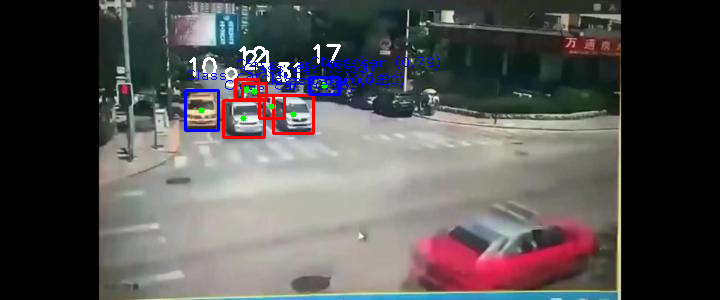

/content/drive/MyDrive/Yolo/0/14.jpg


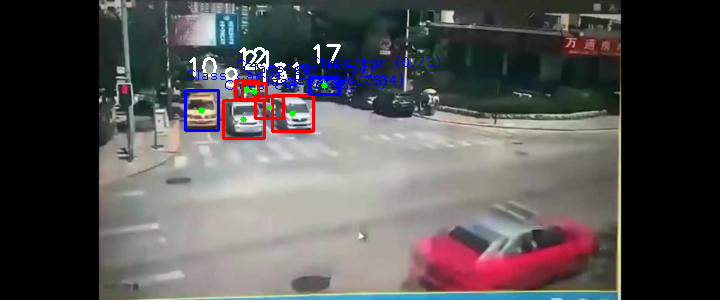

/content/drive/MyDrive/Yolo/0/15.jpg


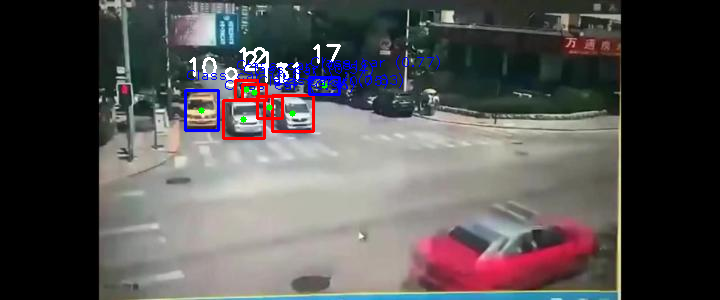

/content/drive/MyDrive/Yolo/0/16.jpg


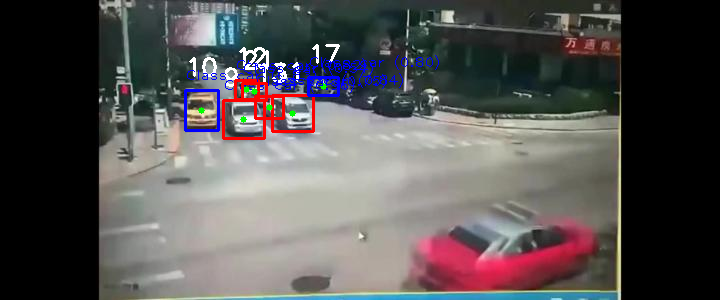

/content/drive/MyDrive/Yolo/0/17.jpg


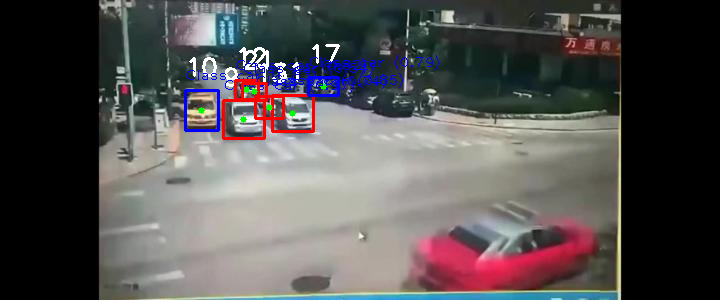

/content/drive/MyDrive/Yolo/0/18.jpg


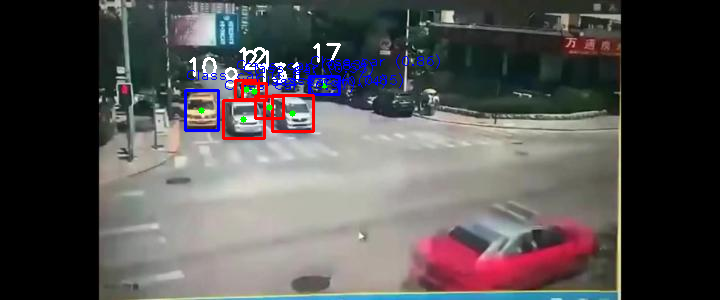

/content/drive/MyDrive/Yolo/0/19.jpg


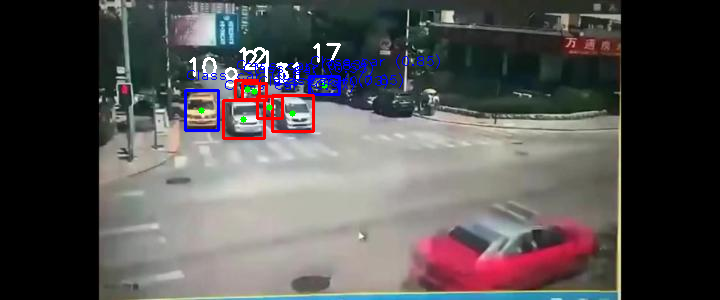

/content/drive/MyDrive/Yolo/0/20.jpg


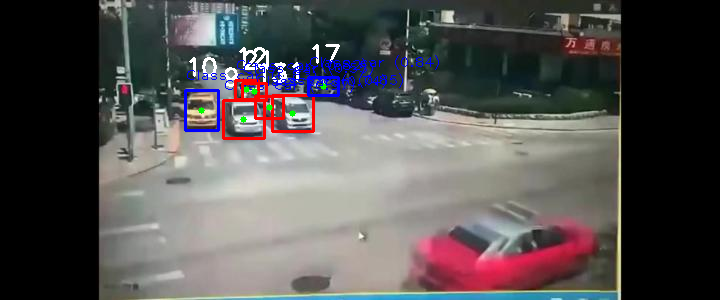

/content/drive/MyDrive/Yolo/0/21.jpg


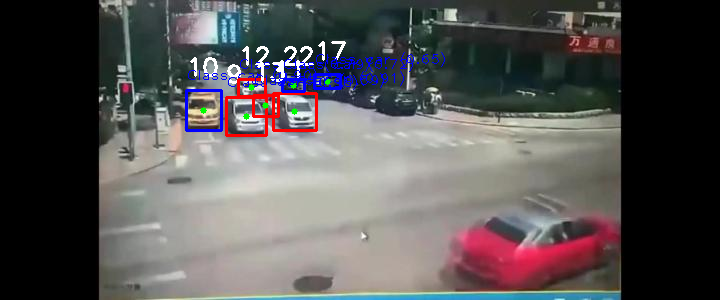

/content/drive/MyDrive/Yolo/0/22.jpg


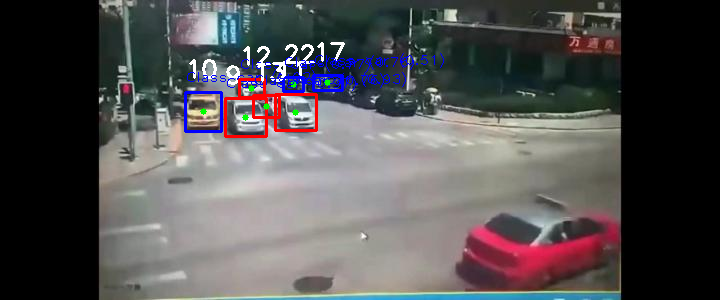

/content/drive/MyDrive/Yolo/0/23.jpg


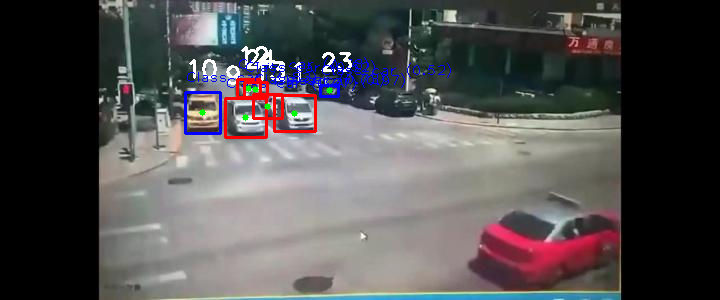

/content/drive/MyDrive/Yolo/0/24.jpg


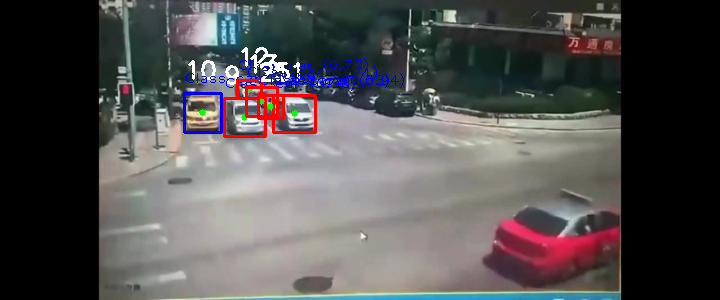

/content/drive/MyDrive/Yolo/0/25.jpg


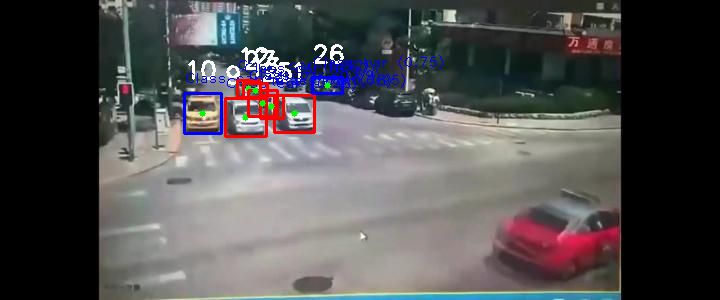

/content/drive/MyDrive/Yolo/0/26.jpg


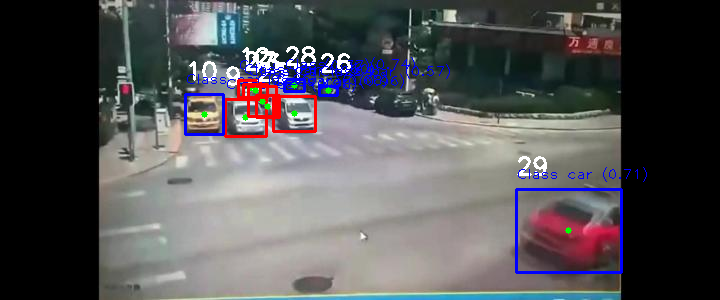

/content/drive/MyDrive/Yolo/0/27.jpg


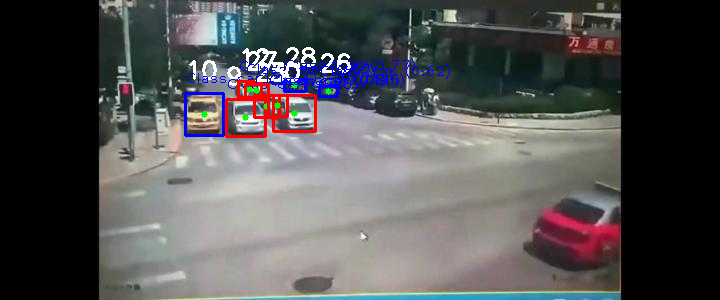

/content/drive/MyDrive/Yolo/0/28.jpg


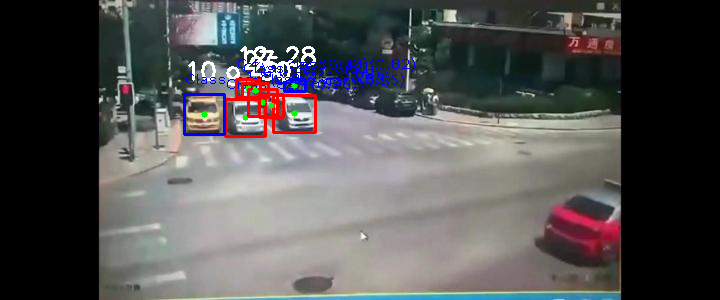

/content/drive/MyDrive/Yolo/0/29.jpg


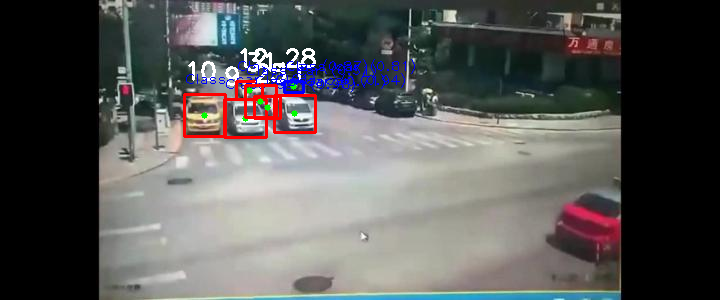

/content/drive/MyDrive/Yolo/0/30.jpg


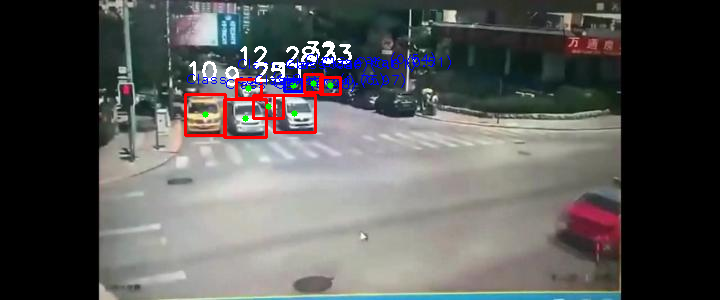

/content/drive/MyDrive/Yolo/0/31.jpg


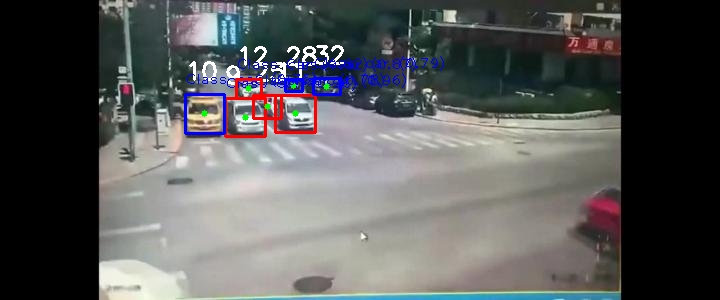

/content/drive/MyDrive/Yolo/0/32.jpg


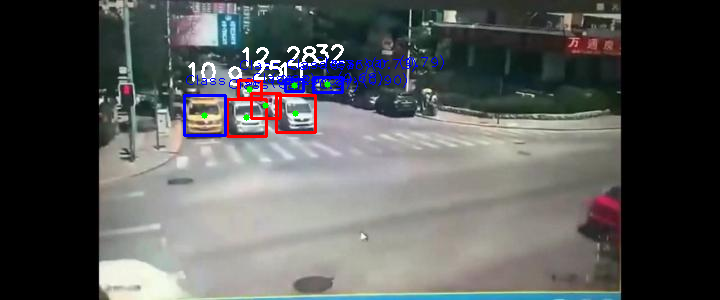

/content/drive/MyDrive/Yolo/0/33.jpg


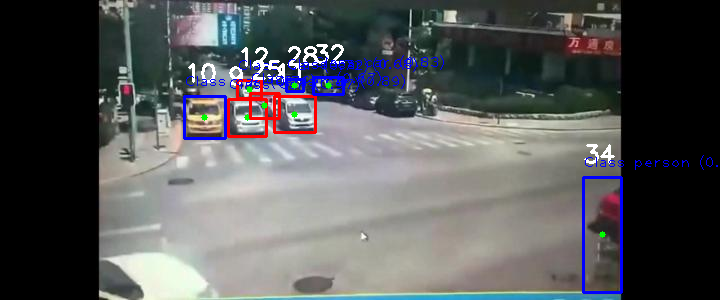

/content/drive/MyDrive/Yolo/0/34.jpg


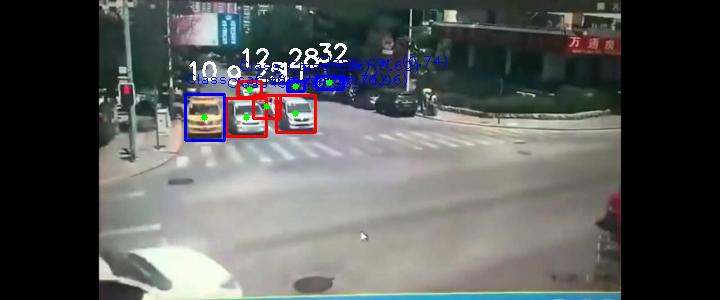

/content/drive/MyDrive/Yolo/0/35.jpg


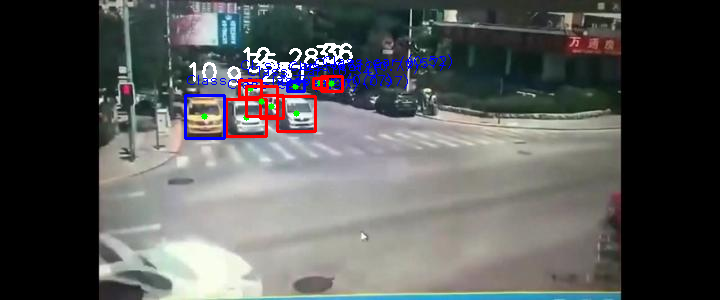

/content/drive/MyDrive/Yolo/0/36.jpg


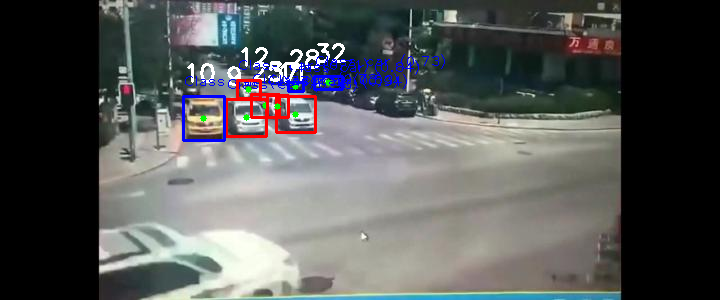

/content/drive/MyDrive/Yolo/0/37.jpg


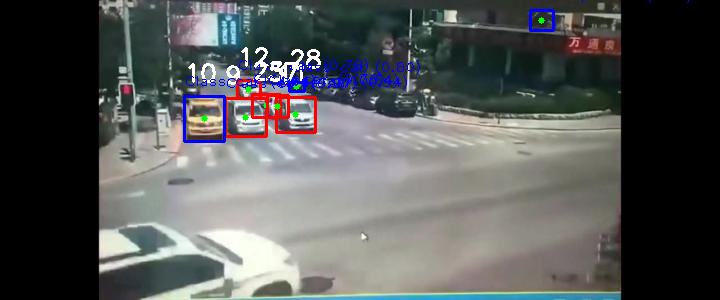

/content/drive/MyDrive/Yolo/0/38.jpg


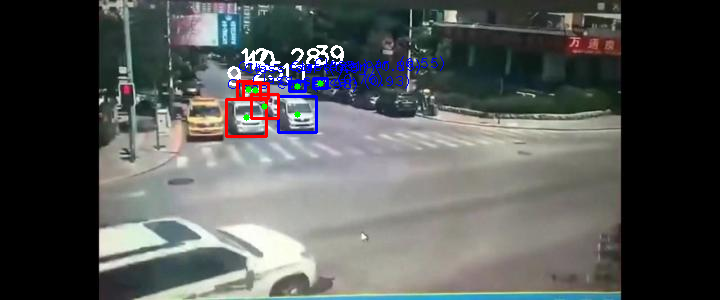

/content/drive/MyDrive/Yolo/0/39.jpg


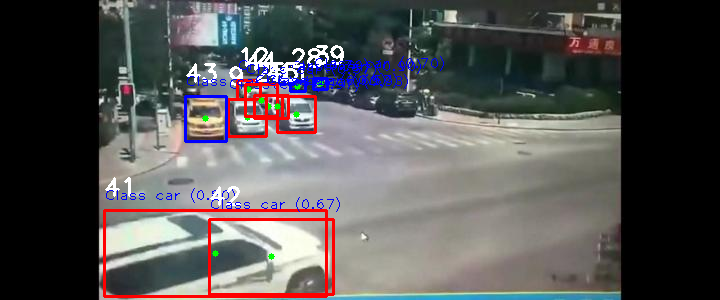

/content/drive/MyDrive/Yolo/0/40.jpg


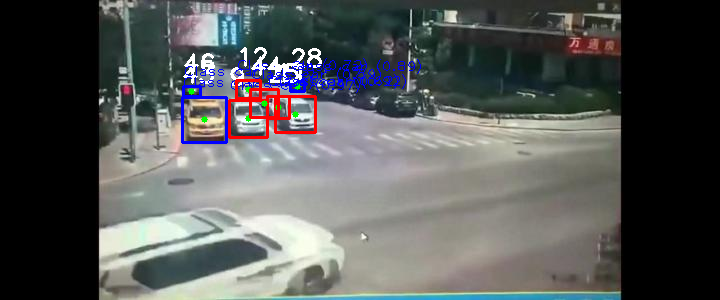

/content/drive/MyDrive/Yolo/0/41.jpg


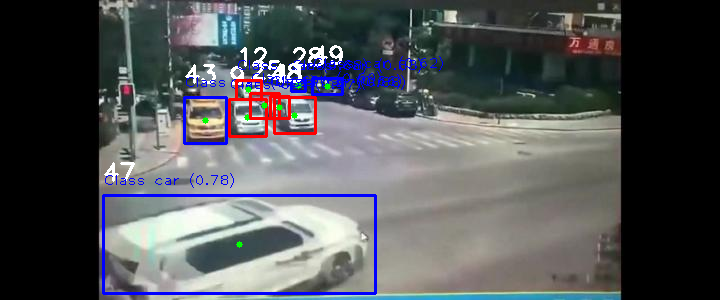

/content/drive/MyDrive/Yolo/0/42.jpg


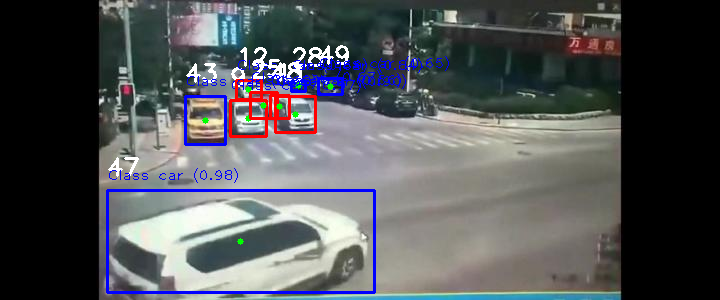

/content/drive/MyDrive/Yolo/0/43.jpg


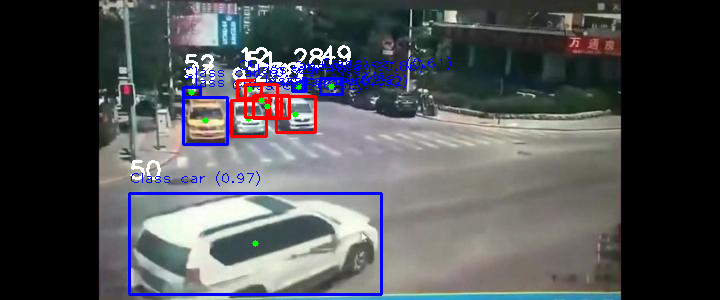

/content/drive/MyDrive/Yolo/0/44.jpg


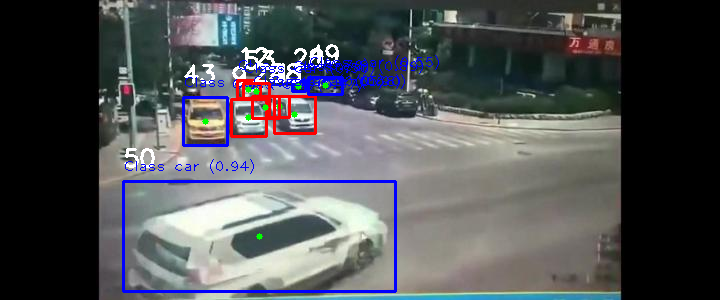

/content/drive/MyDrive/Yolo/0/45.jpg


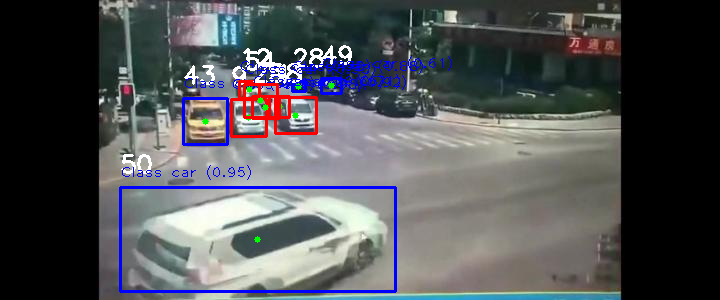

/content/drive/MyDrive/Yolo/0/46.jpg


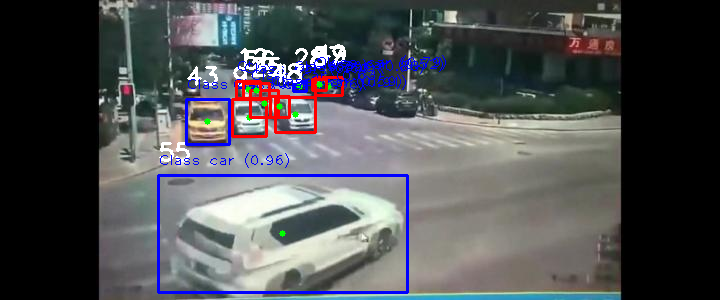

/content/drive/MyDrive/Yolo/0/47.jpg


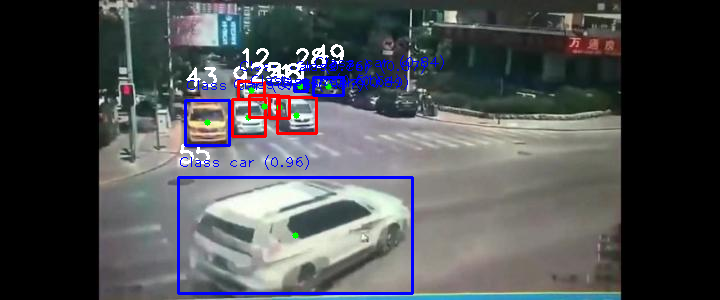

/content/drive/MyDrive/Yolo/0/48.jpg


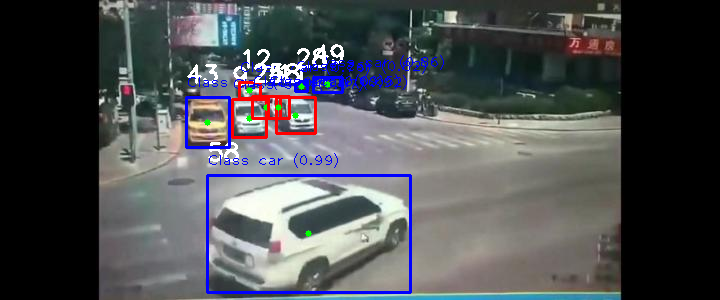

/content/drive/MyDrive/Yolo/0/49.jpg


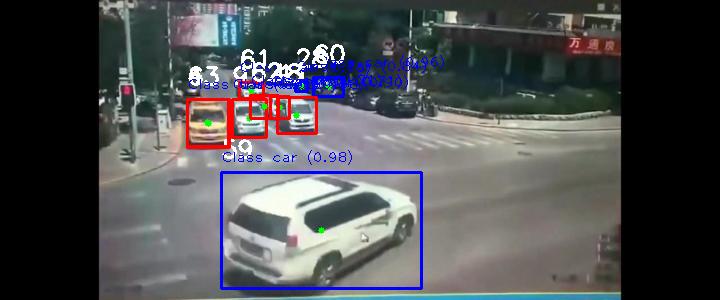

/content/drive/MyDrive/Yolo/0/50.jpg


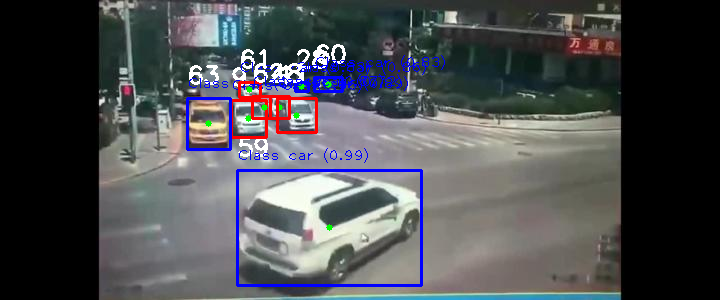

/content/drive/MyDrive/Yolo/0/51.jpg


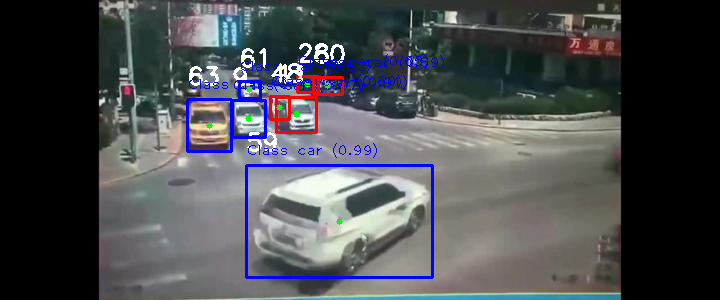

/content/drive/MyDrive/Yolo/0/52.jpg


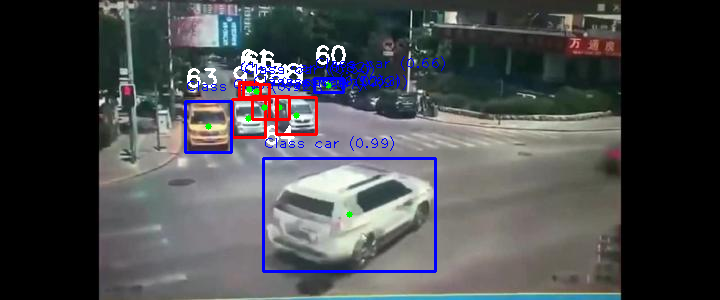

/content/drive/MyDrive/Yolo/0/53.jpg


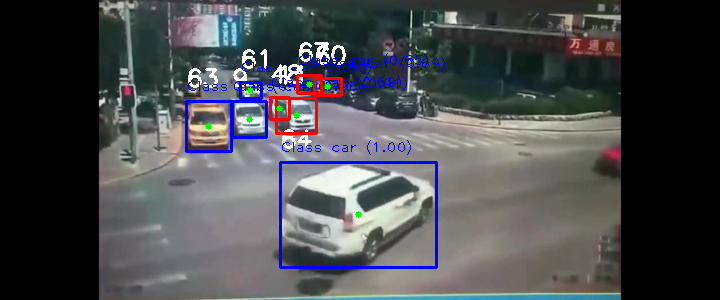

/content/drive/MyDrive/Yolo/0/54.jpg


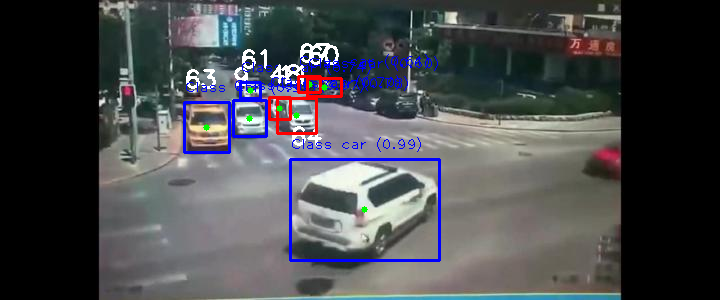

/content/drive/MyDrive/Yolo/0/55.jpg


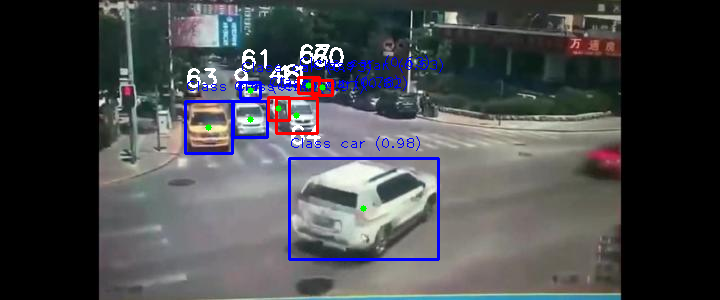

/content/drive/MyDrive/Yolo/0/56.jpg


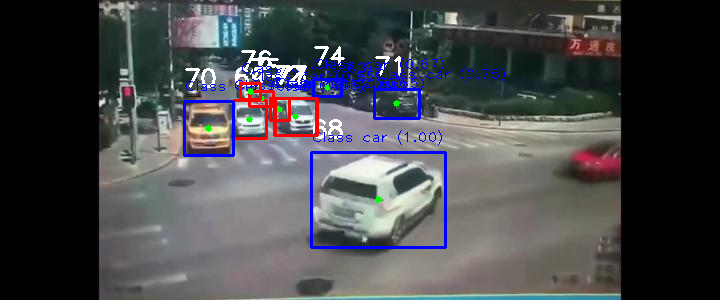

/content/drive/MyDrive/Yolo/0/57.jpg


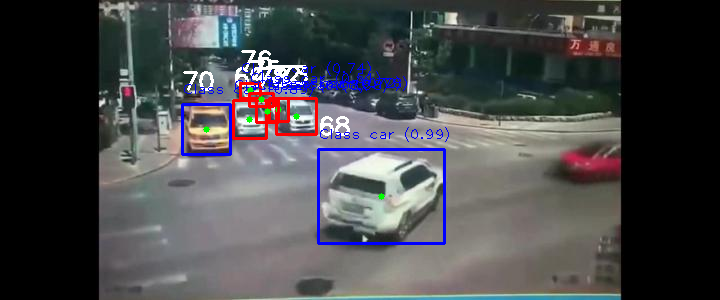

/content/drive/MyDrive/Yolo/0/58.jpg


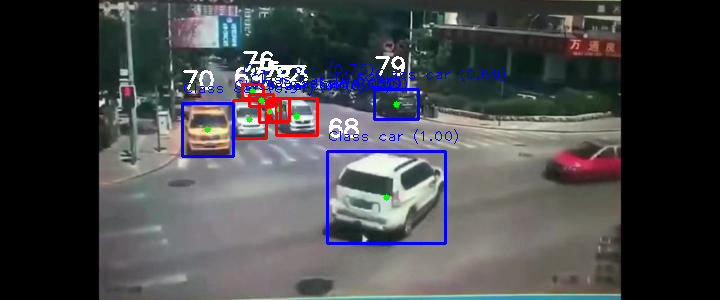

/content/drive/MyDrive/Yolo/0/59.jpg


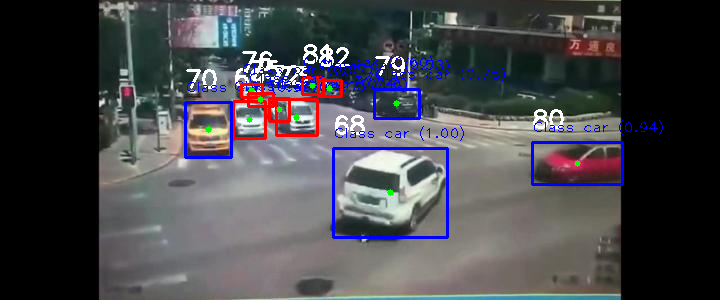

/content/drive/MyDrive/Yolo/0/60.jpg


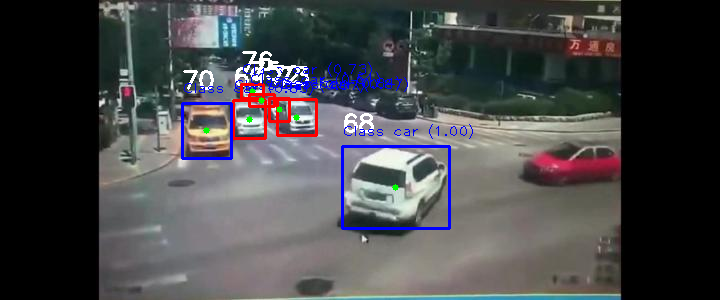

/content/drive/MyDrive/Yolo/0/61.jpg


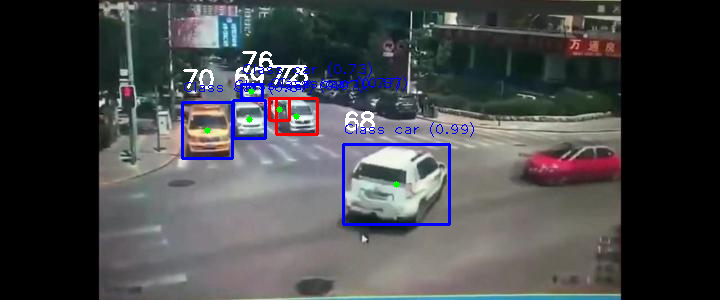

/content/drive/MyDrive/Yolo/0/62.jpg


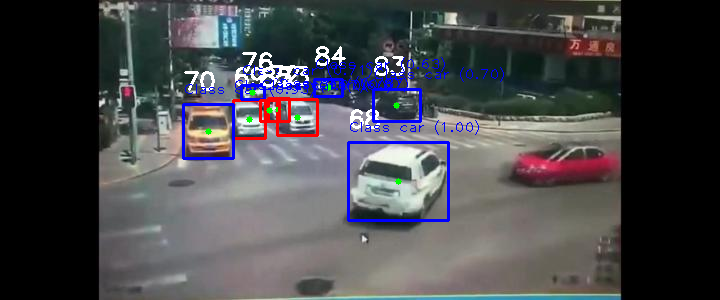

/content/drive/MyDrive/Yolo/0/63.jpg


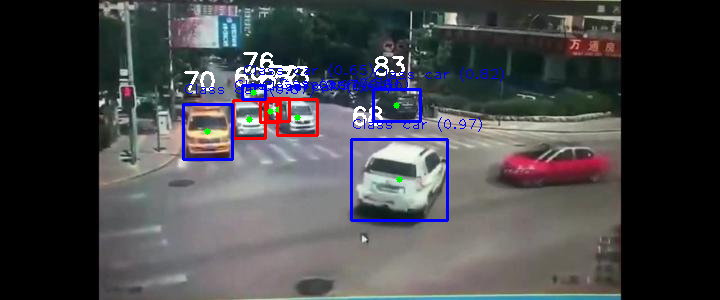

/content/drive/MyDrive/Yolo/0/64.jpg


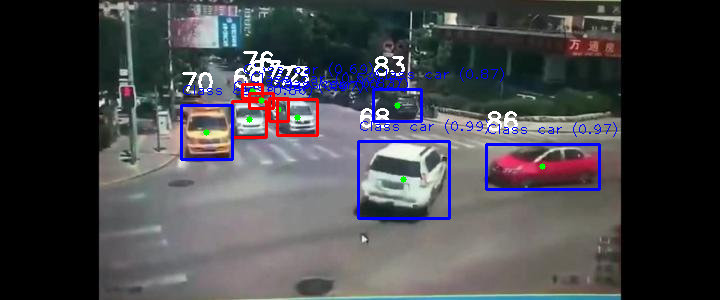

/content/drive/MyDrive/Yolo/0/65.jpg


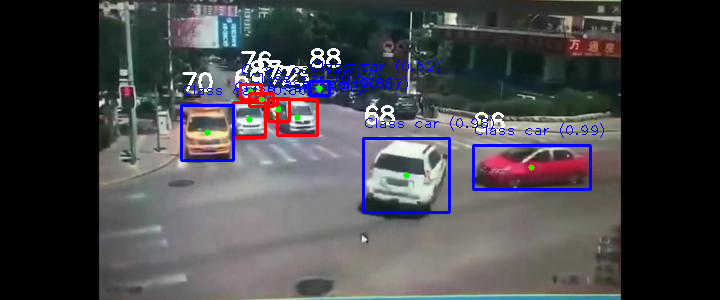

/content/drive/MyDrive/Yolo/0/66.jpg


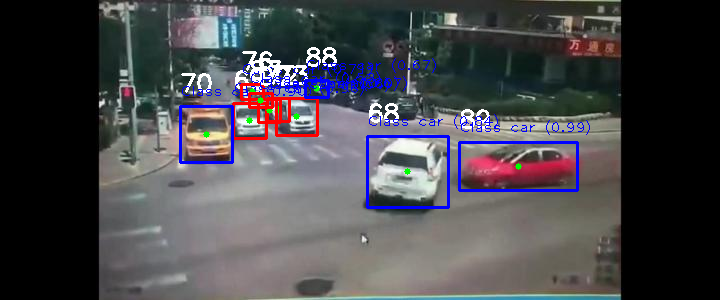

/content/drive/MyDrive/Yolo/0/67.jpg


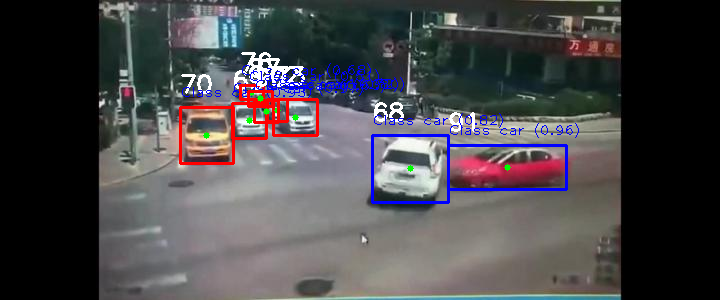

/content/drive/MyDrive/Yolo/0/68.jpg


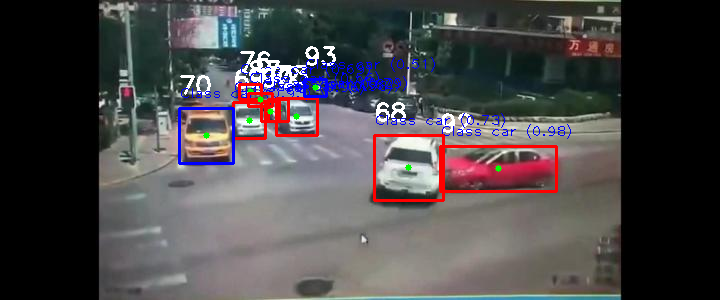

/content/drive/MyDrive/Yolo/0/69.jpg


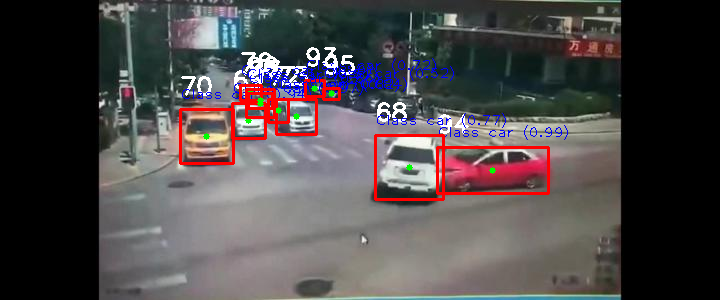

/content/drive/MyDrive/Yolo/0/70.jpg


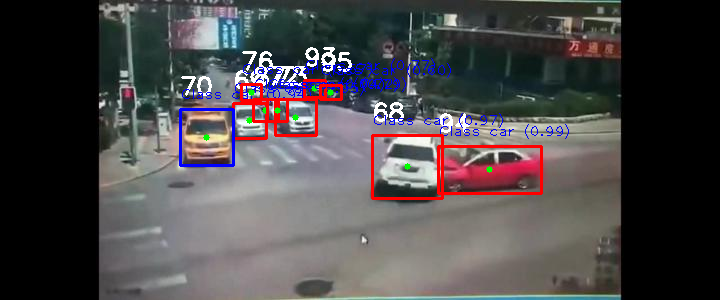

/content/drive/MyDrive/Yolo/0/71.jpg


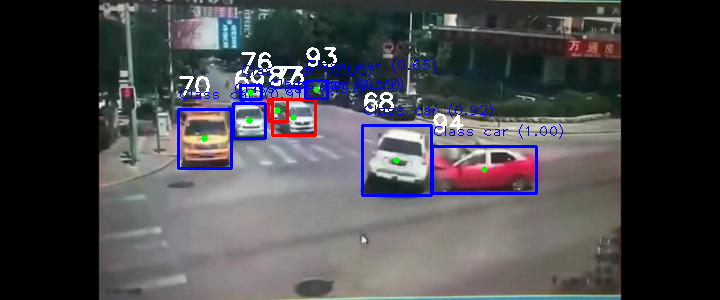

/content/drive/MyDrive/Yolo/0/72.jpg


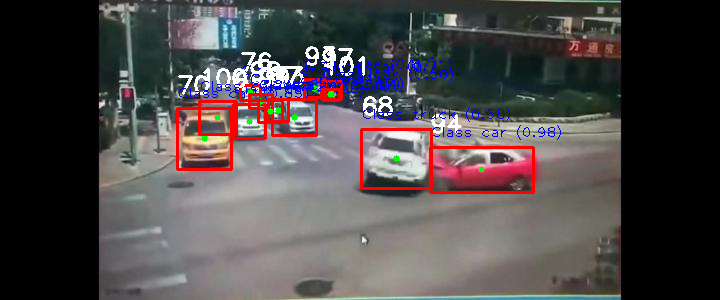

/content/drive/MyDrive/Yolo/0/73.jpg


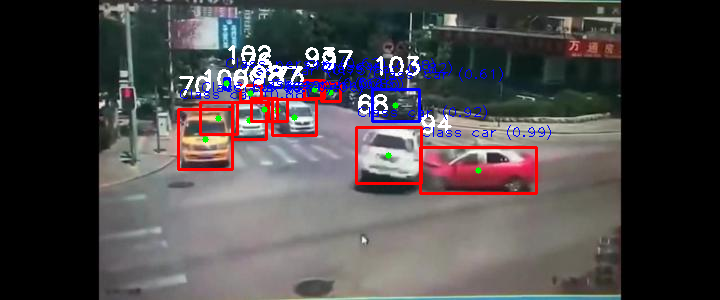

/content/drive/MyDrive/Yolo/0/74.jpg


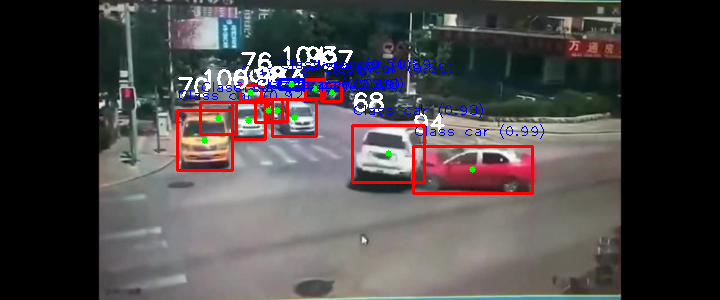

/content/drive/MyDrive/Yolo/0/75.jpg


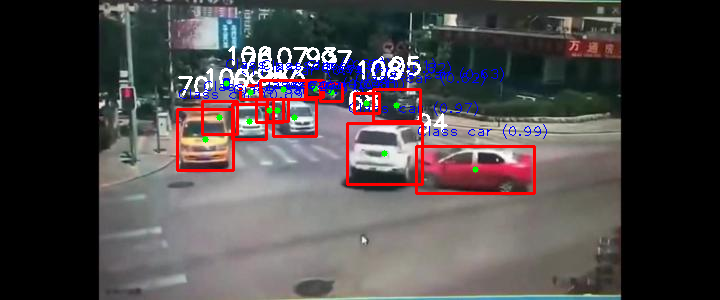

/content/drive/MyDrive/Yolo/0/76.jpg


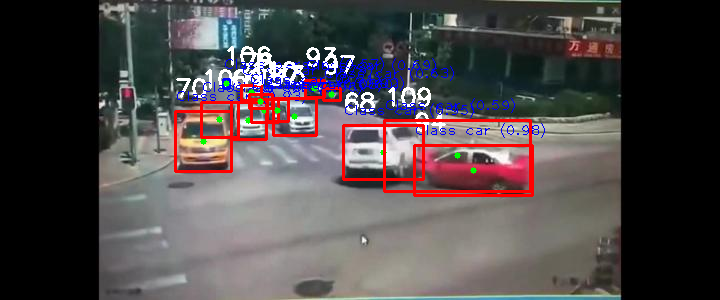

/content/drive/MyDrive/Yolo/0/77.jpg


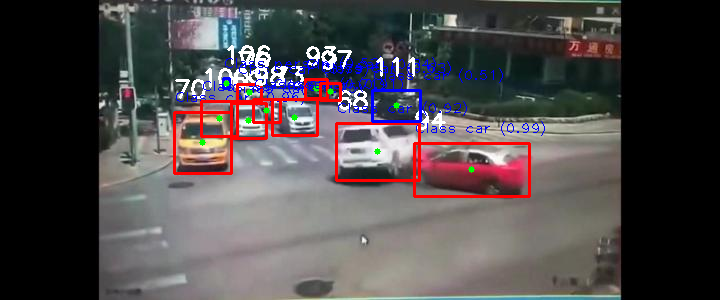

/content/drive/MyDrive/Yolo/0/78.jpg


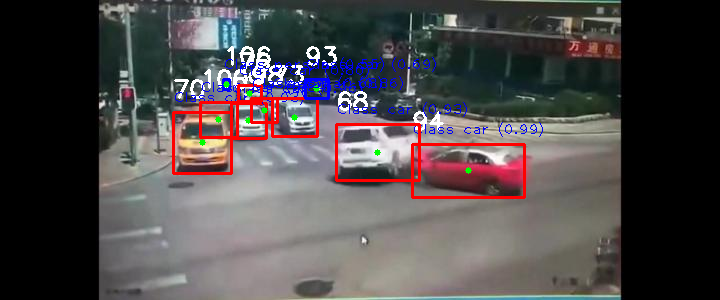

/content/drive/MyDrive/Yolo/0/79.jpg


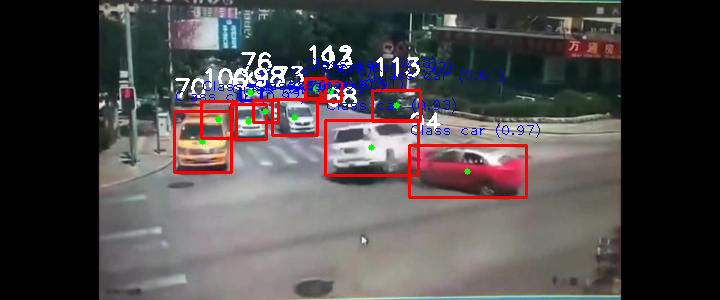

/content/drive/MyDrive/Yolo/0/80.jpg


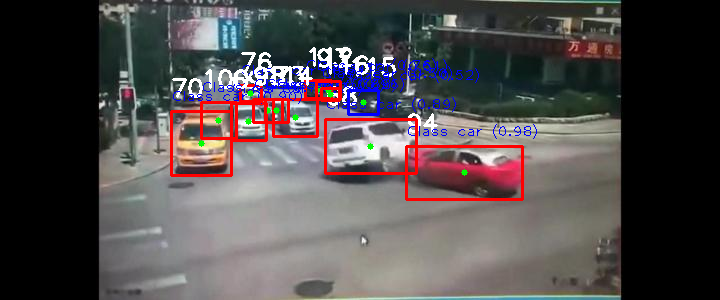

/content/drive/MyDrive/Yolo/0/81.jpg


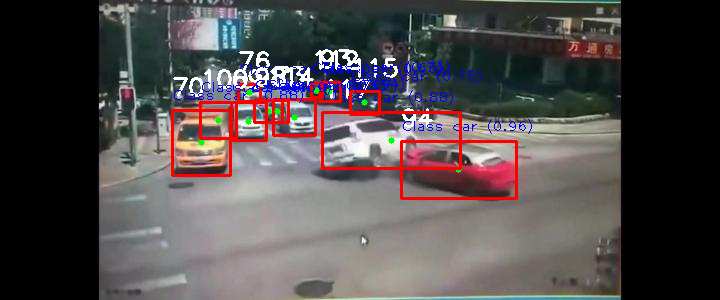

/content/drive/MyDrive/Yolo/0/82.jpg


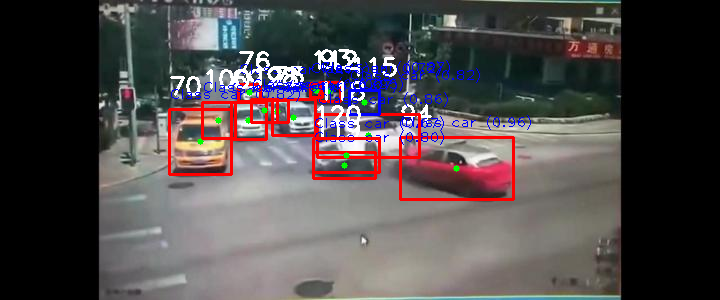

/content/drive/MyDrive/Yolo/0/83.jpg


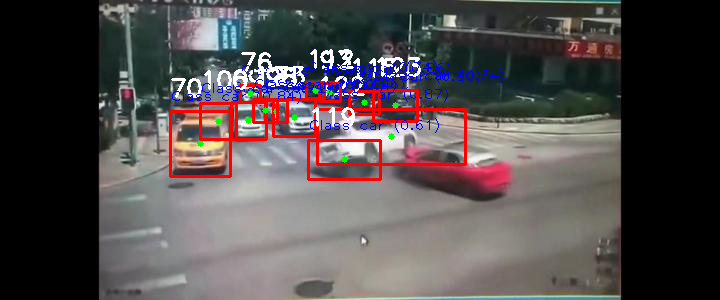

/content/drive/MyDrive/Yolo/0/84.jpg


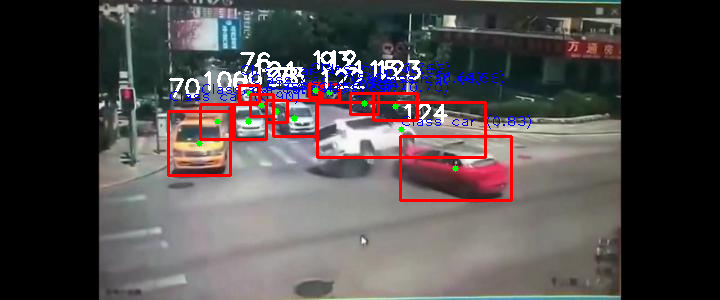

/content/drive/MyDrive/Yolo/0/85.jpg


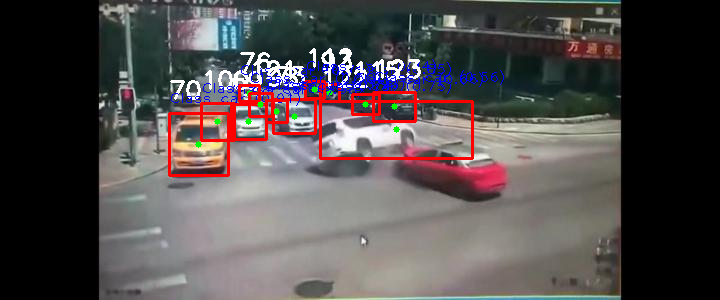

/content/drive/MyDrive/Yolo/0/86.jpg


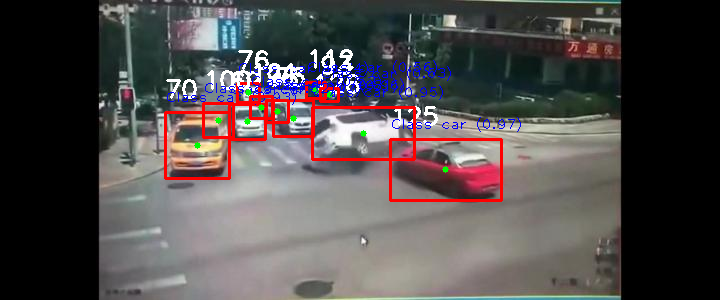

/content/drive/MyDrive/Yolo/0/87.jpg


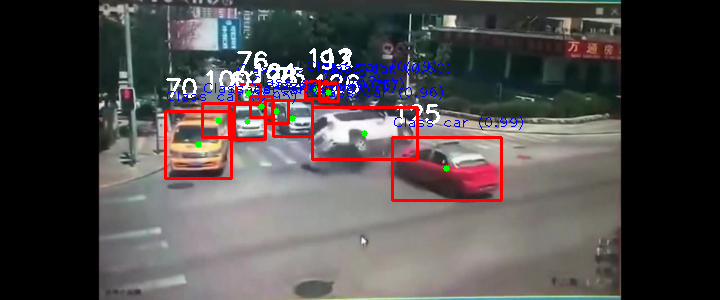

/content/drive/MyDrive/Yolo/0/88.jpg


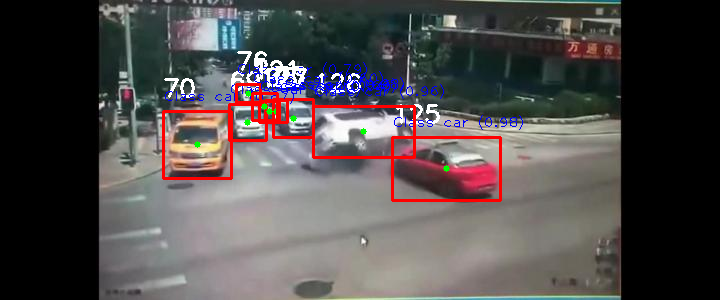

/content/drive/MyDrive/Yolo/0/89.jpg


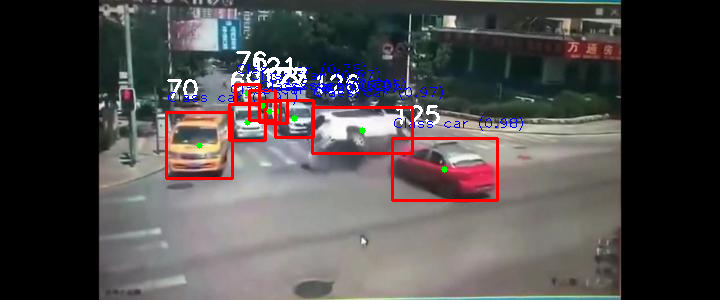

/content/drive/MyDrive/Yolo/0/90.jpg


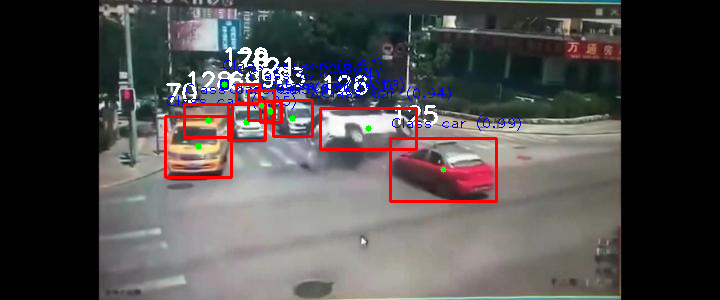

/content/drive/MyDrive/Yolo/0/91.jpg


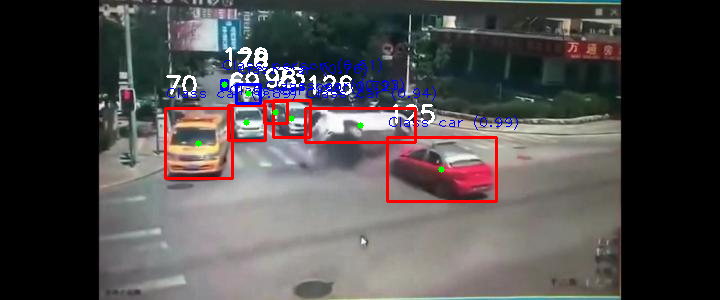

/content/drive/MyDrive/Yolo/0/92.jpg


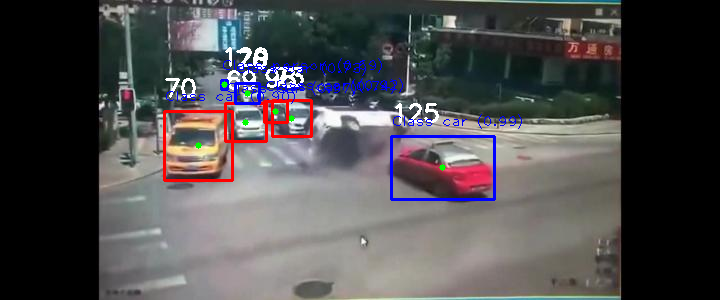

/content/drive/MyDrive/Yolo/0/93.jpg


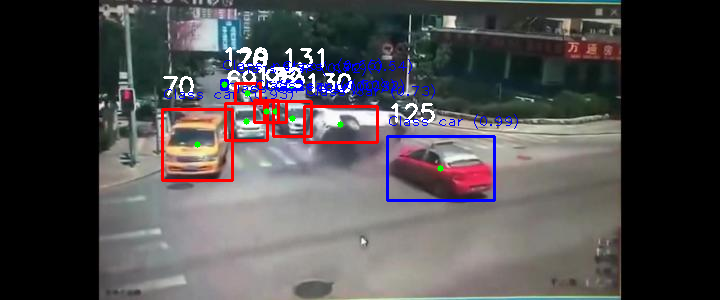

/content/drive/MyDrive/Yolo/0/94.jpg


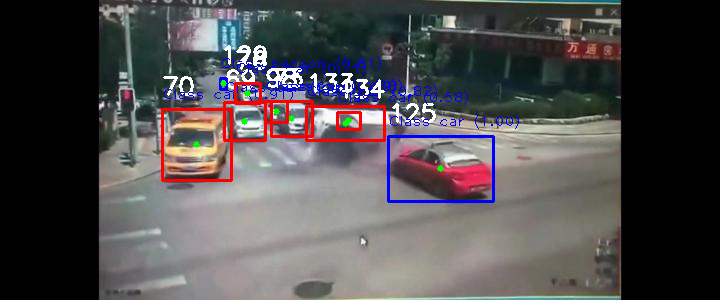

/content/drive/MyDrive/Yolo/0/95.jpg


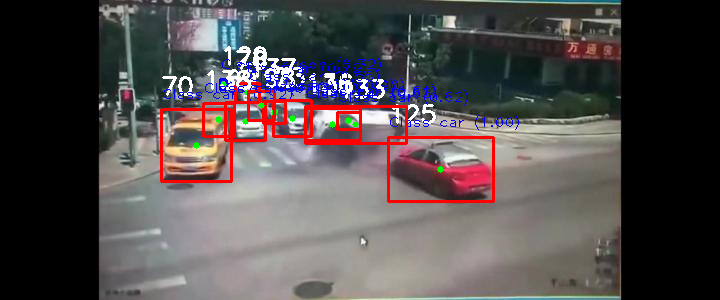

/content/drive/MyDrive/Yolo/0/96.jpg


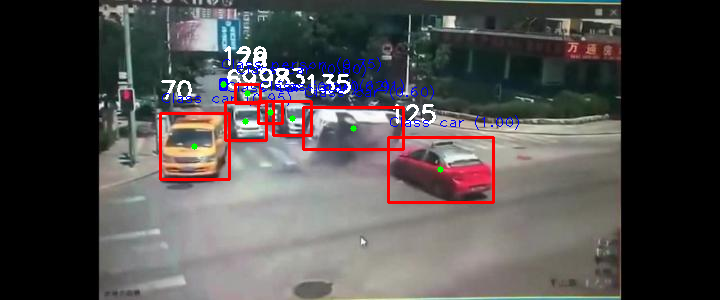

/content/drive/MyDrive/Yolo/0/97.jpg


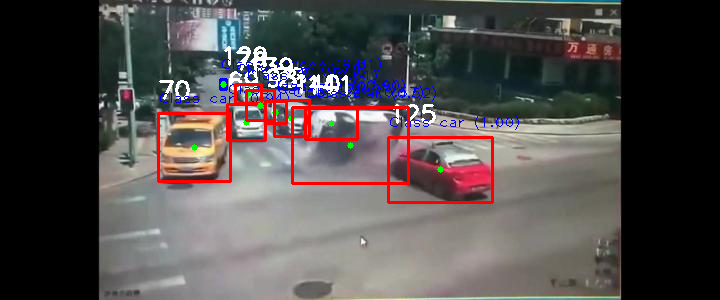

/content/drive/MyDrive/Yolo/0/98.jpg


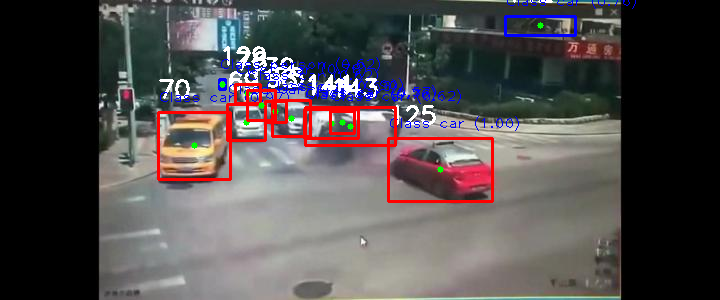

/content/drive/MyDrive/Yolo/0/99.jpg


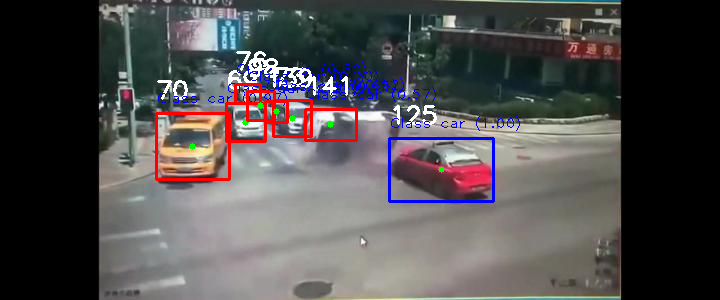

In [ ]:
# -*- coding: utf-8 -*-
"""
Modified for Mask R-CNN
"""
import cv2
import os
from google.colab.patches import cv2_imshow
import torch
from torchvision.models.detection import MaskRCNN_ResNet50_FPN_Weights, maskrcnn_resnet50_fpn
import torchvision.transforms as T
from IPython.display import display, clear_output
import PIL.Image

COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
    'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 'umbrella', 'N/A', 'N/A',
    'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
    'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket',
    'bottle', 'N/A', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl',
    'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
    'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table',
    'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard',
    'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A',
    'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]
tracker = EuclideanDistTracker()


#Check if GPU is available (T4 recommended)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

#Enable performance optimization
torch.backends.cudnn.benchmark = True

#Load the Mask R-CNN model with pre-trained COCO weights
model = maskrcnn_resnet50_fpn(weights=MaskRCNN_ResNet50_FPN_Weights.COCO_V1).to(device)
model.eval()

# Define image transformation for the model input
transform = T.Compose([T.ToTensor()])

def predict(chosen_model, img, conf=0.5):
    # Convert image to tensor and normalize
    img_tensor = transform(img).unsqueeze(0).to(device)  # Add batch dimension

    with torch.no_grad():
        results = chosen_model(img_tensor)  # Get predictions

    return results[0]  # Mask R-CNN returns a list, we take the first result

def predict_and_detect(chosen_model, img, conf=0.65, rectangle_thickness=2, text_thickness=1, prev_objects=[]):
    results = predict(chosen_model, img, conf)

    objects=[]

    for i in range(len(results["boxes"])):
        score = results["scores"][i].item()
        if score < conf:
            continue  # Skip low-confidence detections

        label_index = results["labels"][i].item()  # Class label
        label = COCO_INSTANCE_CATEGORY_NAMES[label_index] # get label name
        # Extract bounding box coordinates
        x1, y1, x2, y2 = map(int, results["boxes"][i])
        id=-1
        obj=TrackedObject(label,x1, y1, x2, y2,id,label,score)
        if obj.cat in ['truck', 'motorcycle', 'person', 'car']:
          objects.append(obj)
    boxes = tracker.update(objects)
    for box in boxes:
      result = next((obj for obj in prev_objects if obj.id == box.id),None)
      if not result == None:
        box.past_centroids=result.past_centroids
    get_overlap_info(boxes)
    for box in boxes:
        cv2.putText(img, str(box.id),(box.x1,box.y1-15),  cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255,255,255), 2)
        cv2.rectangle(img, (box.x1,box.y1),(box.x2, box.y2), (255,255,255), 2)
        # Draw bounding box
        box.past_centroids.append(box.centroid)
        #print(box.past_centroids)
        if not box.overlaps:
          cv2.rectangle(img, (box.x1, box.y1), (box.x2, box.y2), (255, 0, 0), rectangle_thickness)
        else:
          cv2.rectangle(img, (box.x1, box.y1), (box.x2, box.y2), (0, 0, 255), rectangle_thickness)

        # Add class label
        cv2.putText(img, f"Class {box.cat} ({box.cat_prob:.2f})",
                    (box.x1, box.y1 - 10), cv2.FONT_HERSHEY_PLAIN, 1, (255, 0, 0), text_thickness)
        box.past_centroids.append(box.centroid) #store the current centroid.
        for past_centroid in box.past_centroids:
          cv2.circle(img, past_centroid, 3, (0, 255, 0), -1)
        prev_objects=boxes

    return img, results

# Read a sample image
image = cv2.imread("/content/drive/MyDrive/Yolo/img/sample2.jpg")
if image is not None:
    result_img, _ = predict_and_detect(model, image, conf=0.5)
    cv2_imshow(result_img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

# Process video frames
frames_folder = '/content/drive/MyDrive/Yolo/0'

def extract_number(filename):
    try:
        return int(os.path.splitext(filename)[0])
    except ValueError:
        return float('inf')

frame_filenames = sorted(
    [f for f in os.listdir(frames_folder) if f.endswith('.jpg')],
    key=extract_number
)

frame_filenames = [os.path.join(frames_folder, f) for f in frame_filenames]

# Initialize VideoWriter
frame_size = (480, 360)
fps = 10
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter("output_file.avi", fourcc, fps, frame_size)
prev_objects=[]
for frame_filename in frame_filenames:
    frame = cv2.imread(frame_filename)
    #frame = cv2.imread("/content/drive/MyDrive/Yolo/img/sample2.jpg")
    if frame is None:
        continue

    result_frame, _ = predict_and_detect(model, frame, conf=0.5, prev_objects=prev_objects)
    #cv2_imshow(result_frame)
    print(frame_filename)
    out.write(result_frame)
    #Convert to PIL format for proper display in Jupyter/Colab
    result_frame_rgb = cv2.cvtColor(result_frame, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    result_pil = PIL.Image.fromarray(result_frame_rgb)
    #Display only the current frame
    #clear_output(wait=True)  # ✅ Clear previous frame
    display(result_pil)
    #if cv2.waitKey(30) & 0xFF == ord('q'):
      #  break



out.release()
cv2.destroyAllWindows()
